In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os

import torch

import sae_bench.custom_saes.custom_sae_config as custom_sae_config
import sae_bench.custom_saes.relu_sae as relu_sae
import sae_bench.custom_saes.run_all_evals_custom_saes as run_all_evals_custom_saes
import sae_bench.evals.core.main as core
import sae_bench.evals.sparse_probing.main as sparse_probing
import sae_bench.sae_bench_utils.general_utils as general_utils
from sae_bench.sae_bench_utils.sae_selection_utils import get_saes_from_regex

RANDOM_SEED = 42

output_folders = {
    "absorption": "eval_results/absorption",
    "autointerp": "eval_results/autointerp",
    "core": "eval_results/core",
    "scr": "eval_results/scr",
    "tpp": "eval_results/tpp",
    "sparse_probing": "eval_results/sparse_probing",
    "unlearning": "eval_results/unlearning",
}

# Note: Unlearning is not recommended for models with < 2B parameters and we recommend an instruct tuned model
# Unlearning will also require requesting permission for the WMDP dataset (see unlearning/README.md)
# Absorption not recommended for models < 2B parameters
# asyncio doesn't like notebooks, so autointerp must be ran using a python script

# Select your eval types here.
eval_types = [
    "absorption",
    # "autointerp",
    "core",
    "scr",
    "tpp",
    "sparse_probing",
    # "unlearning",
]

if "autointerp" in eval_types:
    raise ValueError("autointerp must be ran using a python script")

device = general_utils.setup_environment()

model_name = "pythia-70m-deduped"
llm_batch_size = 512
torch_dtype = torch.float32

# Currently all evals take str_dtype instead of torch_dtype. We did this for serialization purposes, but it was probably a mistake.
# For now we will just use the str_dtype. TODO: Fix this
str_dtype = torch_dtype.__str__().split(".")[-1]


# If evaluating multiple SAEs on the same layer, set save_activations to True
# This will require at least 100GB of disk space
save_activations = False

/root/repos/sparse_auto_encoders/.venv/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using device: cuda


This cell loads your custom SAEs. If you just want to use existing SAE Lens SAEs, comment it out.


In [3]:
repo_id = "canrager/lm_sae"
baseline_filename = (
    "pythia70m_sweep_standard_ctx128_0712/resid_post_layer_4/trainer_8/ae.pt"
)
hook_layer = 4
hook_name = f"blocks.{hook_layer}.hook_resid_post"

# sae = relu_sae.load_dictionary_learning_relu_sae(
#     repo_id, baseline_filename, model_name, device, torch_dtype, layer=hook_layer
# )
from src.models import SparseAutoencoder, TopK
d_in = 512
d_sae = 1024
sae = SparseAutoencoder(
        n_inputs=512,
        n_latents=1024,
        activation=TopK(1024),
        tied=True,
        normalize=False,
)
sae.dtype = torch.float32
sae.device = "cuda"
sae.W_dec = sae.decoder.weight
sae.W_enc = sae.encoder.weight
with torch.no_grad():
    sae.W_dec = sae.W_dec / torch.linalg.norm(sae.W_dec, dim=1, keepdim=True)

print(f"sae dtype: {sae.dtype}, device: {sae.device}")

assert d_sae >= d_in

print(f"d_in: {d_in}, d_sae: {d_sae}")

sae dtype: torch.float32, device: cuda
d_in: 512, d_sae: 1024


In our sae object we need to have a CustomSAEConfig. This contains some information which is used by the evals (hook_name, hook_layer, model_name, d_sae, etc). In addition, it contains information that is used by our plotting functions, like number of training tokens and architecture. For example, we should have the sae.cfg.architecture defined if we want to plot multiple SAE architectures.

Note: Everything in this cell, except `architecture` and `training_tokens`, is done in the `BaseSAE` class that the `ReluSAE` inherits from. Because of this, we recommend that you modify an existing SAE class.


In [4]:
sae.cfg = custom_sae_config.CustomSAEConfig(
    model_name, d_in=d_in, d_sae=d_sae, hook_name=hook_name, hook_layer=hook_layer
)

# Core evals require us to specify cfg.dtype, which must be a string for easy serialization. TODO: Refactor to use torch.dtype
sae.cfg.dtype = str_dtype


# The following contains our current defined SAE types and the shapes to plot for each. Add your custom SAE as new_sae_key
new_sae_key = "vanilla"
trainer_markers = {
    "standard": "o",
    "jumprelu": "X",
    "topk": "^",
    "p_anneal": "*",
    "gated": "d",
    new_sae_key: "s",  # New SAE
}

trainer_colors = {
    "standard": "blue",
    "jumprelu": "orange",
    "topk": "green",
    "p_anneal": "red",
    "gated": "purple",
    new_sae_key: "black",  # New SAE
}

sae.cfg.architecture = new_sae_key
sae.cfg.training_tokens = 200_000_000

`selected_saes` is a list of tuples of (unique_sae_id, sae object) OR (sae lens release, sae lens id). If it is a list of custom sae objects, then memory size will increase with the length of the list. This is especially important if the SAEs are large. If memory is a concern, I recommend calling the `run_eval()` function multiple times with lists of length 1, each list containing a new sae object.


In [5]:
# Note: the custom_sae_id should be unique, as it is used for the intermediate results and final results file names

unique_custom_sae_id = "my_awesome_sae_id" #baseline_filename.replace("/", "_").replace(".", "_")
print(f"sae_id: {unique_custom_sae_id}")

# list of tuple of (sae_id, sae object)
custom_saes = [(unique_custom_sae_id, sae)]

sae_id: my_awesome_sae_id


Select your baseline SAEs here. Refer to `sae_regex_selection.ipynb` for more regex patterns. We are going to get a topk SAE from the same layer.


In [6]:
sae_regex_pattern = r"(sae_bench_pythia70m_sweep_topk_ctx128_0730).*"
sae_block_pattern = r".*blocks\.([4])\.hook_resid_post__trainer_(8)$"

baseline_saes = get_saes_from_regex(sae_regex_pattern, sae_block_pattern)
print(f"baseline_saes: {baseline_saes}")
baseline_sae_id = f"{baseline_saes[0][0]}_{baseline_saes[0][1]}".replace(".", "_")
print(f"baseline_sae_id: {baseline_sae_id}")

selected_saes = custom_saes + baseline_saes

100%|██████████| 78/78 [00:00<00:00, 77177.57it/s]

baseline_saes: [('sae_bench_pythia70m_sweep_topk_ctx128_0730', 'blocks.4.hook_resid_post__trainer_8')]
baseline_sae_id: sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks_4_hook_resid_post__trainer_8


Run time for the next 2 functions is approximately 2 minutes on an RTX 3090.


In [7]:
# Note: We typically run with n_eval_sparsity_variance_batches=2000, but I have reduced it here for a faster run

_ = core.multiple_evals(
    selected_saes=selected_saes,
    n_eval_reconstruction_batches=200,
    n_eval_sparsity_variance_batches=200,
    eval_batch_size_prompts=32,
    compute_featurewise_density_statistics=True,
    compute_featurewise_weight_based_metrics=True,
    exclude_special_tokens_from_reconstruction=True,
    dataset="Skylion007/openwebtext",
    context_size=128,
    output_folder="eval_results/core",
    verbose=True,
    dtype=str_dtype,
)

Running SAE evaluation on all selected SAEs:   0%|          | 0/2 [00:00<?, ?it/s]`torch_dtype` is deprecated! Use `dtype` instead!


Loaded pretrained model pythia-70m-deduped into HookedTransformer


/root/repos/sparse_auto_encoders/.venv/lib/python3.13/site-packages/sae_lens/training/activations_store.py:320: UserWarning: Dataset is not tokenized. Pre-tokenizing will improve performance and allows for more control over special tokens. See https://decoderesearch.github.io/SAELens/training_saes/#pretokenizing-datasets for more info.
  warnings.warn(
Sparsity and Variance Batches: 100%|██████████| 200/200 [00:05<00:00, 34.04it/s]


{'feature_density': [0.3188991844654083, 0.38251498341560364, 0.7790975570678711, 0.9444117546081543, 0.41911613941192627, 0.48450765013694763, 0.3833954334259033, 0.08466921001672745, 0.9052911400794983, 0.8766177892684937, 0.7887468934059143, 0.792816698551178, 0.948919951915741, 0.7789769172668457, 0.9266265034675598, 0.3358667492866516, 0.6800134778022766, 0.4274219870567322, 0.853206217288971, 0.3876708745956421, 0.722912073135376, 0.2156085968017578, 0.2173781394958496, 0.5268471837043762, 0.2374008446931839, 0.44777101278305054, 0.5514248609542847, 0.4113791882991791, 0.7384093403816223, 0.9205138087272644, 0.2375756949186325, 0.24965213239192963, 0.7172673344612122, 0.2250855267047882, 0.2930038869380951, 0.6590167284011841, 0.7001531720161438, 0.7422205805778503, 0.16804420948028564, 0.8028514385223389, 0.4018074572086334, 0.29308637976646423, 0.38049671053886414, 0.5561571717262268, 0.36328408122062683, 0.7949408888816833, 0.044961199164390564, 0.35275799036026, 0.52533376216

Failed to evaluate SAE custom_sae from my_awesome_sae_id with context length 128 on dataset Skylion007/openwebtext: list index out of range
Traceback (most recent call last):
  File "/root/repos/sparse_auto_encoders/sae_bench/evals/core/main.py", line 1125, in multiple_evals
    saved_path = save_single_eval_result(
        cleaned_metrics,
    ...<4 lines>...
        sae,
    )
  File "/root/repos/sparse_auto_encoders/sae_bench/evals/core/main.py", line 905, in save_single_eval_result
    feature_metrics_by_feature = convert_feature_metrics(flattened_feature_metrics)
  File "/root/repos/sparse_auto_encoders/sae_bench/evals/core/main.py", line 848, in convert_feature_metrics
    flattened_feature_metrics["encoder_decoder_cosine_sim"][i],
    ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~^^^
IndexError: list index out of range

Running SAE evaluation on all selected SAEs:  50%|█████     | 1/2 [00:39<00:39, 39.68s/it]

{'feature_density': [0.3188991844654083, 0.38251498341560364, 0.7790975570678711, 0.9444117546081543, 0.41911613941192627, 0.48450765013694763, 0.3833954334259033, 0.08466921001672745, 0.9052911400794983, 0.8766177892684937, 0.7887468934059143, 0.792816698551178, 0.948919951915741, 0.7789769172668457, 0.9266265034675598, 0.3358667492866516, 0.6800134778022766, 0.4274219870567322, 0.853206217288971, 0.3876708745956421, 0.722912073135376, 0.2156085968017578, 0.2173781394958496, 0.5268471837043762, 0.2374008446931839, 0.44777101278305054, 0.5514248609542847, 0.4113791882991791, 0.7384093403816223, 0.9205138087272644, 0.2375756949186325, 0.24965213239192963, 0.7172673344612122, 0.2250855267047882, 0.2930038869380951, 0.6590167284011841, 0.7001531720161438, 0.7422205805778503, 0.16804420948028564, 0.8028514385223389, 0.4018074572086334, 0.29308637976646423, 0.38049671053886414, 0.5561571717262268, 0.36328408122062683, 0.7949408888816833, 0.044961199164390564, 0.35275799036026, 0.52533376216

Running SAE evaluation on all selected SAEs: 100%|██████████| 2/2 [00:40<00:00, 20.02s/it]

Failed to fold W_dec norm for sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8
Skipping sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8 as results already exist


In [8]:
# We do a subset of the sparse probing datasets here for shorter runtime
dataset_names = ["LabHC/bias_in_bios_class_set1"]

# TODO: Add a verbose flag
_ = sparse_probing.run_eval(
    sparse_probing.SparseProbingEvalConfig(
        model_name=model_name,
        random_seed=RANDOM_SEED,
        llm_batch_size=llm_batch_size,
        llm_dtype=str_dtype,
        dataset_names=dataset_names,
    ),
    selected_saes,
    device,
    "eval_results/sparse_probing",
    force_rerun=True,
    clean_up_activations=True,
    save_activations=save_activations,
)

Loaded pretrained model pythia-70m-deduped into HookedTransformer


Running SAE evaluation on all selected SAEs:   0%|          | 0/2 [00:00<?, ?it/s]

100%|██████████| 28/28 [00:00<00:00, 711.83it/s]


Removing 12 from test set
Removing 24 from test set


Tokenizing data: 100%|██████████| 5/5 [00:00<00:00, 17.27it/s]


Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
GPU probe training early stopping triggered after 49 epochs
Test accuracy for 0: 0.9050000309944153
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
GPU probe training early stopping triggered after 21 epochs
Test accuracy for 1: 0.9530000686645508
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
GPU probe training early stopping triggered after 32 epochs
Test accuracy for 2: 0.9280000329017639
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
GPU probe training early stopping triggered after 33 epochs
Test accuracy for 6: 0.9920000433921814
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
GPU probe training early stopping triggered after 32 epochs
Test accuracy for 9: 0.9650000333786011
Num non-zero elements: 1
Test 

Running SAE evaluation on all selected SAEs:  50%|█████     | 1/2 [00:25<00:25, 25.49s/it]

Failed to fold W_dec norm for sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8


100%|██████████| 28/28 [00:00<00:00, 714.46it/s]


Removing 12 from test set
Removing 24 from test set


Tokenizing data: 100%|██████████| 5/5 [00:00<00:00, 16.95it/s]


Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
GPU probe training early stopping triggered after 49 epochs
Test accuracy for 0: 0.9050000309944153
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
GPU probe training early stopping triggered after 21 epochs
Test accuracy for 1: 0.9530000686645508
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
GPU probe training early stopping triggered after 32 epochs
Test accuracy for 2: 0.9280000329017639
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
GPU probe training early stopping triggered after 33 epochs
Test accuracy for 6: 0.9920000433921814
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
GPU probe training early stopping triggered after 32 epochs
Test accuracy for 9: 0.9650000333786011
Num non-zero elements: 1
Test 

Running SAE evaluation on all selected SAEs: 100%|██████████| 2/2 [00:49<00:00, 24.83s/it]


In [9]:
import json

import torch

import sae_bench.sae_bench_utils.graphing_utils as graphing_utils


In [10]:
image_path = "./images"

if not os.path.exists(image_path):
    os.makedirs(image_path)

In [11]:
results_folders = ["./eval_results"]

eval_type = "sparse_probing"

eval_folders = []
core_folders = []
for results_folder in results_folders:
    eval_folders.append(f"{results_folder}/{eval_type}")
    core_folders.append(f"{results_folder}/core")

eval_filenames = graphing_utils.find_eval_results_files(eval_folders)
core_filenames = graphing_utils.find_eval_results_files(core_folders)

print(f"eval_filenames: {eval_filenames}")
print(f"core_filenames: {core_filenames}")

eval_filenames: ['./eval_results/sparse_probing/pythia70m_sweep_standard_ctx128_0712_resid_post_layer_4_trainer_8_ae_pt_custom_sae_eval_results.json', './eval_results/sparse_probing/sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8_eval_results.json', './eval_results/sparse_probing/my_awesome_sae_id_custom_sae_eval_results.json']
core_filenames: ['./eval_results/core/pythia70m_sweep_standard_ctx128_0712_resid_post_layer_4_trainer_8_ae_pt_custom_sae_eval_results.json', './eval_results/core/sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8_eval_results.json']


Here we can view the raw results, and we see that both SAEs significantly outperform the residual stream baseline.


In [12]:
eval_results_dict = graphing_utils.get_eval_results(eval_filenames)
core_results_dict = graphing_utils.get_eval_results(core_filenames)

import json
print(json.dumps(list(core_results_dict.keys()), indent=1))
for sae in eval_results_dict:
    print(sae)
    print(type(sae))
    eval_results_dict[sae].update(core_results_dict[sae])


print(eval_results_dict.keys())

[
 "pythia70m_sweep_standard_ctx128_0712_resid_post_layer_4_trainer_8_ae_pt_custom_sae",
 "sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8"
]
pythia70m_sweep_standard_ctx128_0712_resid_post_layer_4_trainer_8_ae_pt_custom_sae
<class 'str'>
sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8
<class 'str'>
my_awesome_sae_id_custom_sae
<class 'str'>


KeyError: 'my_awesome_sae_id_custom_sae'

In [ ]:
baseline_filepath = eval_filenames[0]

with open(baseline_filepath) as f:
    baseline_sae_eval_results = json.load(f)

custom_filepath = eval_filenames[1]

with open(custom_filepath) as f:
    custom_sae_eval_results = json.load(f)

k = 1

print(baseline_sae_eval_results.keys())

print(
    f"Baseline SAE top {k} accuracy was:",
    baseline_sae_eval_results["eval_result_metrics"]["sae"][
        f"sae_top_{k}_test_accuracy"
    ],
)
print(
    f"Custom SAE top {k} accuracy was:",
    custom_sae_eval_results["eval_result_metrics"]["sae"][f"sae_top_{k}_test_accuracy"],
)
print(
    f"LLM residual stream top {k} accuracy was:",
    baseline_sae_eval_results["eval_result_metrics"]["llm"][
        f"llm_top_{k}_test_accuracy"
    ],
)

dict_keys(['eval_type_id', 'eval_config', 'eval_id', 'datetime_epoch_millis', 'eval_result_metrics', 'eval_result_details', 'sae_bench_commit_hash', 'sae_lens_id', 'sae_lens_release_id', 'sae_lens_version', 'sae_cfg_dict', 'eval_result_unstructured'])
Baseline SAE top 1 accuracy was: 0.8134
Custom SAE top 1 accuracy was: 0.8426
LLM residual stream top 1 accuracy was: 0.7492


We can also plot the metrics, plotting L0 vs Custom Metric or L0 vs Loss Recovered vs Custom metric. We can have different shapes for the SAE type or dictionary size.


Setting x scale to log because there is at least one positive l0_value


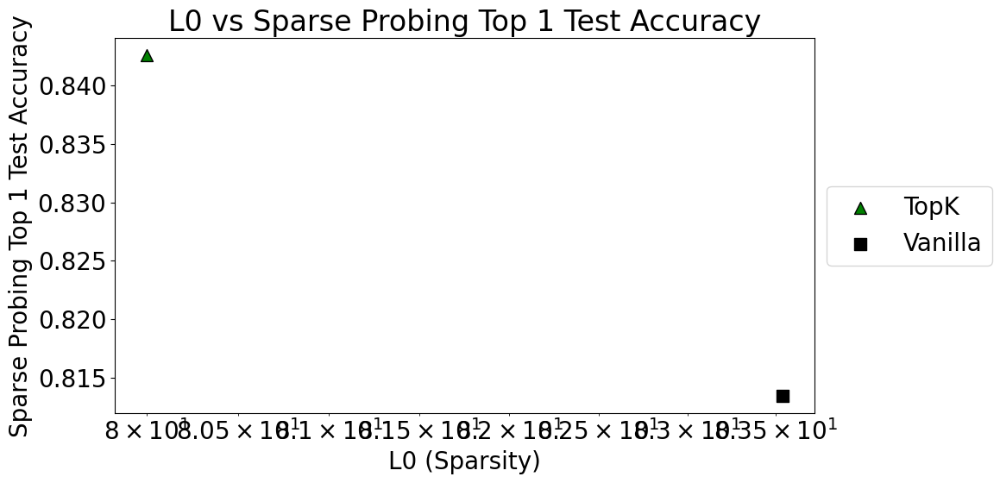

Setting x scale to log because at least one METRIC is positive


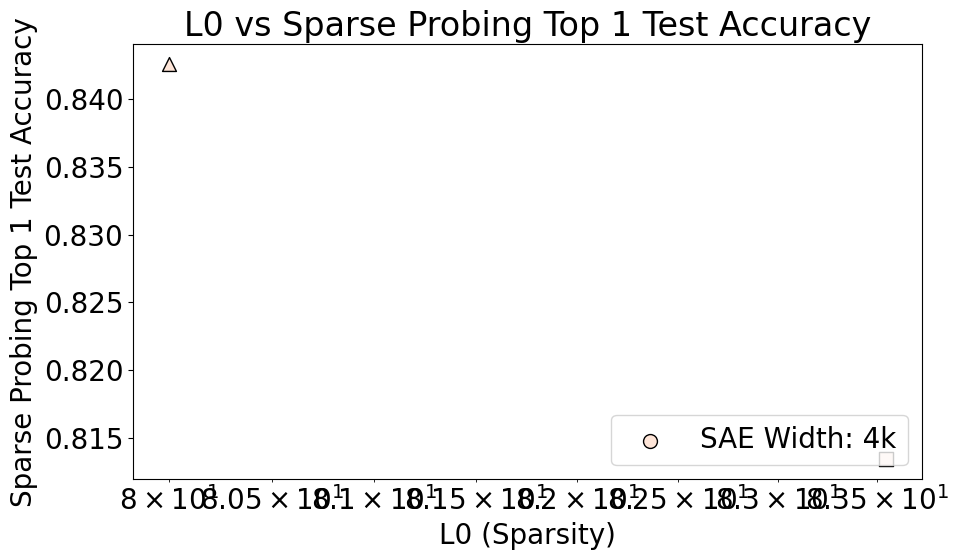

In [ ]:
image_base_name = os.path.join(image_path, "sparse_probing")

graphing_utils.plot_results(
    eval_filenames,
    core_filenames,
    eval_type,
    image_base_name,
    k,
    trainer_markers=trainer_markers,
    trainer_colors=trainer_colors,
)

Now we will run all of the evals, and create more plots. Be warned - this takes around an hour. Note that a significant amount of the costs are one time per layer - for example, with absorption, we have to train a bunch of probes on a given layer. So, if we have multiple SAEs per layer the cost should be much less than 30 minutes per SAE. In addition, to save disk space usage we currently are not saving activations for reuse by multiple SAEs.

Additionally, we can make this faster by evaluating on a subset of the datasets. Sparse probing and Spurious Correlation Removal both have approximately 8 datasets each. We could lower the time by using fewer datasets at the cost of not having as strong of a signal.


In [ ]:
_ = run_all_evals_custom_saes.run_evals(
    model_name,
    selected_saes,
    llm_batch_size,
    str_dtype,
    device,
    eval_types,
    api_key=None,
    force_rerun=False,
    save_activations=save_activations,
)

Evaluations:   0%|          | 0/5 [00:00<?, ?it/s]




Running absorption evaluation









Loaded pretrained model pythia-70m-deduped into HookedTransformer


Loading probe and training data
Probe for layer 4 not found, training...

















Processing train tokens: 100%|██████████| 34635/34635 [00:00<00:00, 50313.31it/s]




Processing test tokens: 100%|██████████| 8659/8659 [00:00<00:00, 19280.52it/s]










































































































































































































































































































































































100%|██████████| 542/542 [00:21<00:00, 24.96it/s]




























































































100%|██████████| 136/136 [00:05<00:00, 24.82it/s]












































































































































































































































































Training k-sparse probes


Loading validation data


Evaluating raw k-sparse probing scores
Building metadata


Evaluations:  20%|██        | 1/5 [04:09<16:37, 249.43s/it]




Cannot evaluate absorption due to insufficent first-letter features detected in model: pythia-70m-deduped






Running core evaluation





Skipping pythia70m_sweep_standard_ctx128_0712_resid_post_layer_4_trainer_8_ae_pt_custom_sae as results already exist


Evaluations:  40%|████      | 2/5 [04:09<05:08, 102.95s/it]

Failed to fold W_dec norm for sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8
Skipping sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8 as results already exist



Running scr evaluation



Loaded pretrained model pythia-70m-deduped into HookedTransformer









Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  4.48it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 17.07it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.9950000643730164
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.9940000176429749
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9440000653266907
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9420000314712524
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9960000514984131
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9960000514984131
dir: 1, original_acc: 0.6740000247955322, clean_acc: 0.9440000653266907, changed_acc: 0.83








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  4.56it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 18.20it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.9860000610351562
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.9860000610351562
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9330000281333923
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9300000667572021
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9960000514984131
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9960000514984131
dir: 1, original_acc: 0.597000002861023, clean_acc: 0.9330000281333923, changed_acc: 0.758








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  4.62it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 17.50it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.9810000658035278
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.9810000658035278
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9500000476837158
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9500000476837158
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.999000072479248
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.999000072479248
dir: 1, original_acc: 0.6810000538825989, clean_acc: 0.9500000476837158, changed_acc: 0.8160








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  4.56it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 17.88it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.9920000433921814
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.9920000433921814
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9380000233650208
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9390000700950623
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.999000072479248
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.999000072479248
dir: 1, original_acc: 0.5740000009536743, clean_acc: 0.9380000233650208, changed_acc: 0.7570




























Generating train split: 100%|██████████| 597682/597682 [00:03<00:00, 184681.44 examples/s]








Generating test split: 100%|██████████| 142500/142500 [00:00<00:00, 190047.61 examples/s]







Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  3.79it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 12.66it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.8110000491142273
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.8110000491142273
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.987000048160553
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9860000610351562
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9810000658035278
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9820000529289246
dir: 1, original_acc: 0.8700000643730164, clean_acc: 0.987000048160553, changed_acc: 0.8710








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  3.69it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 11.79it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.8060000538825989
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.8060000538825989
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9330000281333923
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9320000410079956
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9570000171661377
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9600000381469727
dir: 1, original_acc: 0.8330000638961792, clean_acc: 0.9330000281333923, changed_acc: 0.84








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  3.39it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 11.80it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.8630000352859497
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.8670000433921814
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9520000219345093
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9540000557899475
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9750000238418579
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9760000705718994
dir: 1, original_acc: 0.8920000195503235, clean_acc: 0.9520000219345093, changed_acc: 0.88








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  3.44it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 10.55it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.8350000381469727
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.8380000591278076
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.8980000615119934
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.8970000147819519
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9740000367164612
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9740000367164612
dir: 1, original_acc: 0.7820000648498535, clean_acc: 0.8980000615119934, changed_acc: 0.78

Failed to fold W_dec norm for sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8









Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  4.35it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 16.78it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.9950000643730164
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.9940000176429749
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9440000653266907
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9420000314712524
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9960000514984131
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9960000514984131
dir: 1, original_acc: 0.6740000247955322, clean_acc: 0.9440000653266907, changed_acc: 0.84








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  4.61it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 17.93it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.9860000610351562
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.9860000610351562
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9330000281333923
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9300000667572021
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9960000514984131
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9960000514984131
dir: 1, original_acc: 0.597000002861023, clean_acc: 0.9330000281333923, changed_acc: 0.836








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  4.35it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 17.27it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.9810000658035278
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.9810000658035278
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9500000476837158
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9500000476837158
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.999000072479248
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.999000072479248
dir: 1, original_acc: 0.6810000538825989, clean_acc: 0.9500000476837158, changed_acc: 0.9140








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  4.45it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 17.18it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.9920000433921814
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.9920000433921814
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9380000233650208
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9390000700950623
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.999000072479248
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.999000072479248
dir: 1, original_acc: 0.5740000009536743, clean_acc: 0.9380000233650208, changed_acc: 0.8610








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  3.42it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 11.22it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.8110000491142273
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.8110000491142273
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.987000048160553
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9860000610351562
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9810000658035278
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9820000529289246
dir: 1, original_acc: 0.8700000643730164, clean_acc: 0.987000048160553, changed_acc: 0.9100








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  3.30it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 11.94it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.8060000538825989
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.8060000538825989
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9330000281333923
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9320000410079956
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9570000171661377
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9600000381469727
dir: 1, original_acc: 0.8330000638961792, clean_acc: 0.9330000281333923, changed_acc: 0.85








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  3.02it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 10.79it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.8630000352859497
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.8670000433921814
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.9520000219345093
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.9540000557899475
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9750000238418579
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9760000705718994
dir: 1, original_acc: 0.8920000195503235, clean_acc: 0.9520000219345093, changed_acc: 0.89








Tokenizing data: 100%|██████████| 6/6 [00:01<00:00,  3.32it/s]




Tokenizing data: 100%|██████████| 6/6 [00:00<00:00, 10.69it/s]









































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male / female: 0.8350000381469727
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_data_only: 0.8380000591278076
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for professor / nurse: 0.8980000615119934
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for nurse_data_only: 0.8970000147819519
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for male_professor / female_nurse: 0.9740000367164612
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for female_nurse_data_only: 0.9740000367164612
dir: 1, original_acc: 0.7820000648498535, clean_acc: 0.8980000615119934, changed_acc: 0.78

Evaluations:  60%|██████    | 3/5 [24:56<20:50, 625.01s/it]




Running tpp evaluation



Loaded pretrained model pythia-70m-deduped into HookedTransformer



100%|██████████| 28/28 [00:00<00:00, 407.18it/s]

100%|██████████| 28/28 [00:00<00:00, 717.14it/s]


Removing 12 from test set
Removing 24 from test set








Tokenizing data: 100%|██████████| 5/5 [00:01<00:00,  4.39it/s]



Tokenizing data: 100%|██████████| 5/5 [00:00<00:00, 17.09it/s]


































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 0: 0.8960000276565552
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 1: 0.9520000219345093
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 2: 0.9160000681877136
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 6: 0.9850000739097595
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 9: 0.9610000252723694




100%|██████████| 34/34 [00:00<00:00, 244.21it/s]

100%|██████████| 31/31 [00:00<00:00, 590.16it/s]


Removing 0 from train set
Removing 31 from train set
Removing 28 from train set
Removing 29 from train set
Removing 7 from train set








Tokenizing data: 100%|██████████| 5/5 [00:01<00:00,  3.14it/s]



Tokenizing data: 100%|██████████| 5/5 [00:00<00:00, 10.46it/s]


































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 1: 0.8810000419616699
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 2: 0.8690000176429749
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 3: 0.8670000433921814
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 5: 0.8440000414848328
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 6: 0.7700000405311584


Failed to fold W_dec norm for sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8



100%|██████████| 28/28 [00:00<00:00, 407.84it/s]

100%|██████████| 28/28 [00:00<00:00, 729.36it/s]


Removing 12 from test set
Removing 24 from test set








Tokenizing data: 100%|██████████| 5/5 [00:01<00:00,  4.27it/s]



Tokenizing data: 100%|██████████| 5/5 [00:00<00:00, 17.03it/s]


































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 0: 0.8960000276565552
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 1: 0.9520000219345093
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 2: 0.9160000681877136
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 6: 0.9850000739097595
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 9: 0.9610000252723694




100%|██████████| 34/34 [00:00<00:00, 245.23it/s]

100%|██████████| 31/31 [00:00<00:00, 594.16it/s]


Removing 0 from train set
Removing 31 from train set
Removing 28 from train set
Removing 29 from train set
Removing 7 from train set








Tokenizing data: 100%|██████████| 5/5 [00:01<00:00,  3.40it/s]



Tokenizing data: 100%|██████████| 5/5 [00:00<00:00, 11.45it/s]


































Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 1: 0.8810000419616699
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 2: 0.8690000176429749
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 3: 0.8670000433921814
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 5: 0.8440000414848328
Num non-zero elements: 512
Training probe with dim: 512, device: cuda:0, dtype: torch.float32
Test accuracy for 6: 0.7700000405311584


Evaluations:  80%|████████  | 4/5 [29:45<08:12, 492.70s/it]




Running sparse_probing evaluation



Loaded pretrained model pythia-70m-deduped into HookedTransformer


Skipping pythia70m_sweep_standard_ctx128_0712_resid_post_layer_4_trainer_8_ae_pt_custom_sae as results already exist


Evaluations: 100%|██████████| 5/5 [29:48<00:00, 357.65s/it]

Failed to fold W_dec norm for sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8
Skipping sae_bench_pythia70m_sweep_topk_ctx128_0730_blocks.4.hook_resid_post__trainer_8 as results already exist


Not setting x scale to log 


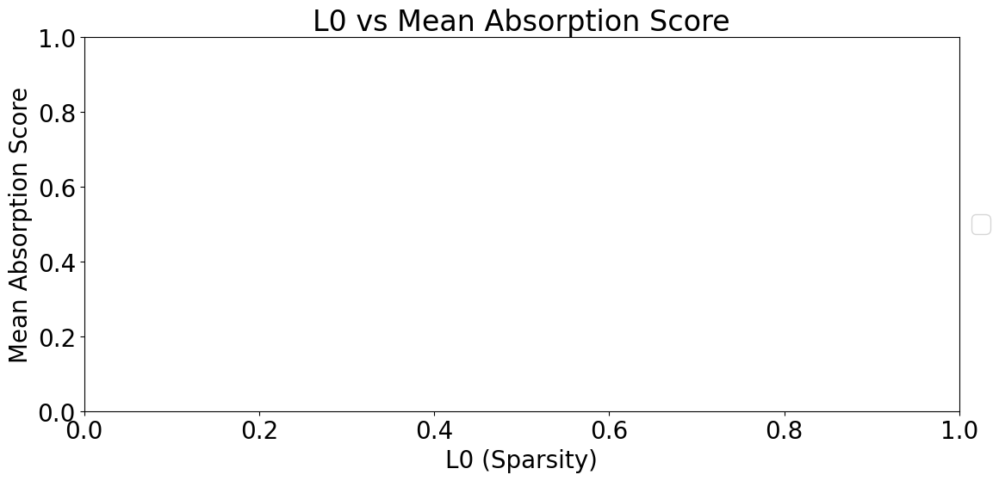

NOT Setting x scale to log because no METRIC is positive


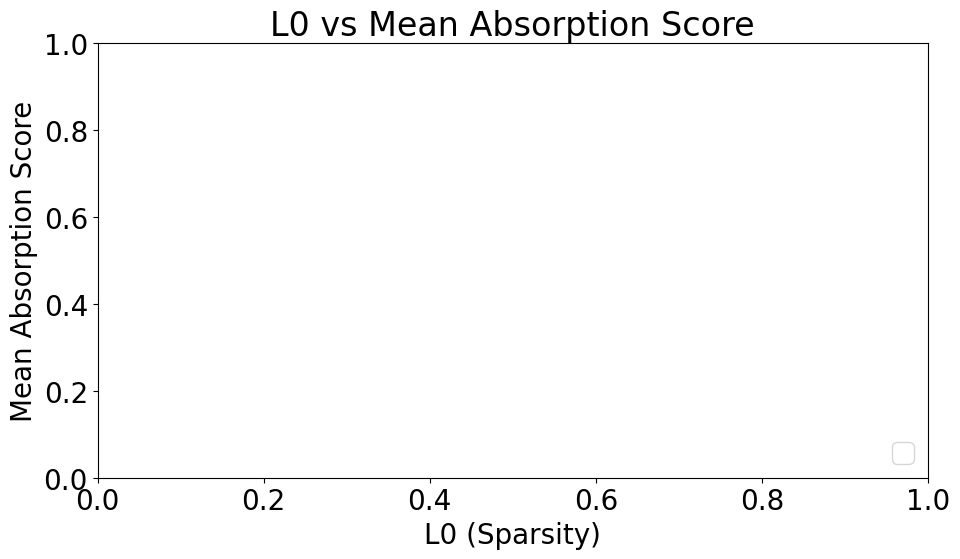

Setting x scale to log because there is at least one positive l0_value


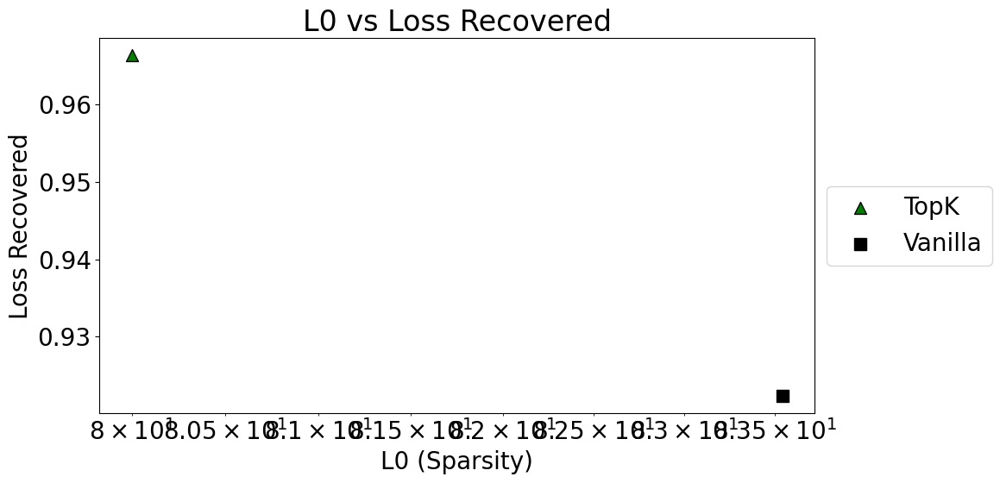

Setting x scale to log because at least one METRIC is positive


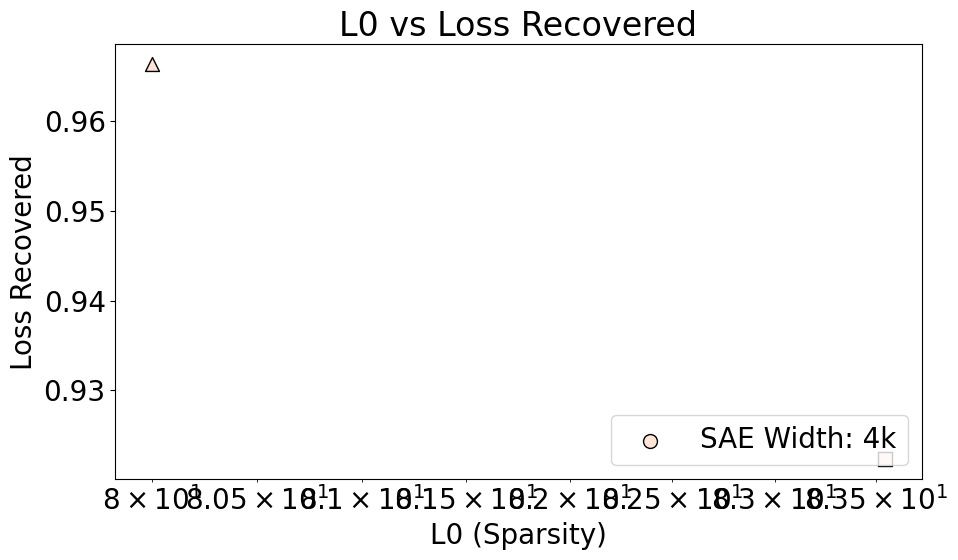

Setting x scale to log because there is at least one positive l0_value


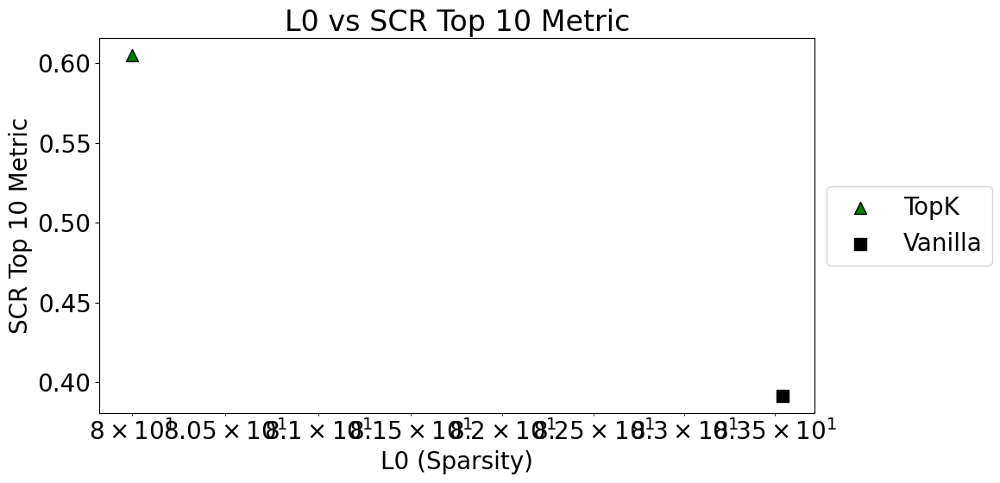

Setting x scale to log because at least one METRIC is positive


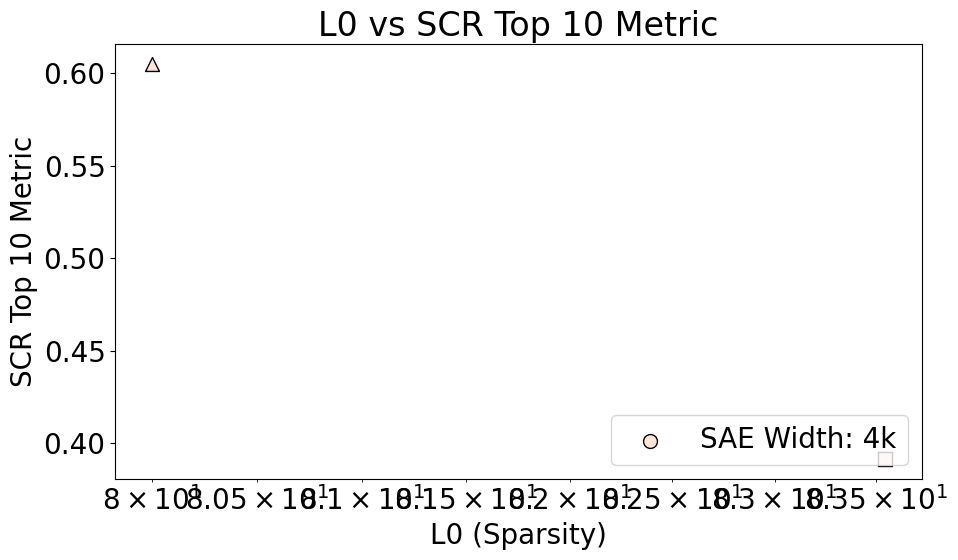

Setting x scale to log because there is at least one positive l0_value


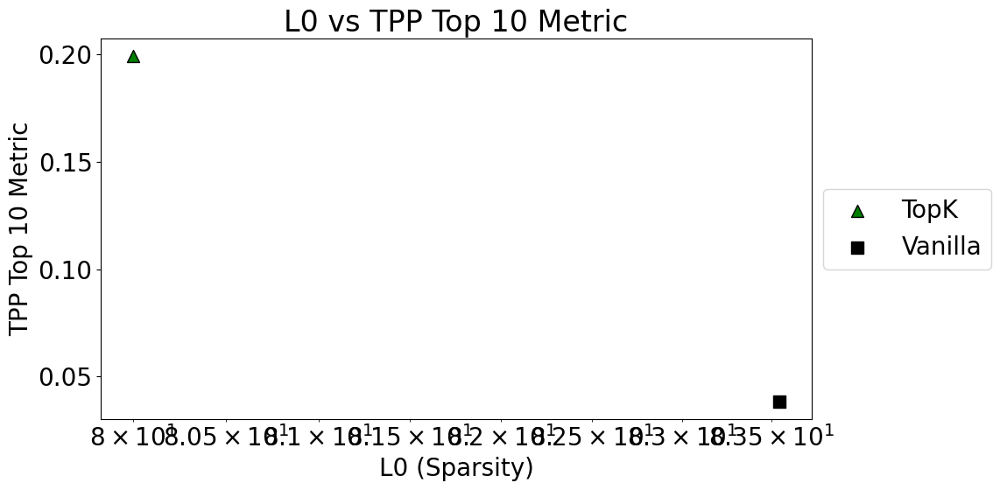

Setting x scale to log because at least one METRIC is positive


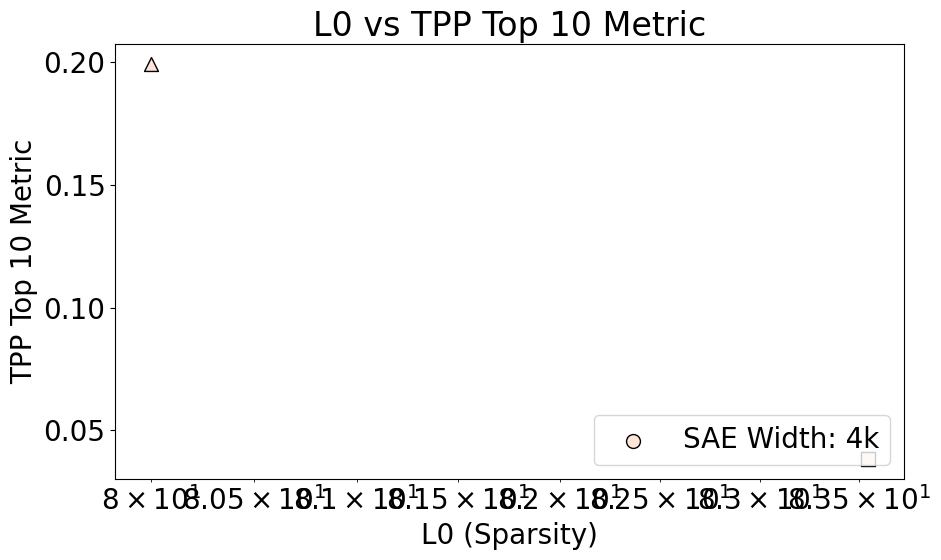

Setting x scale to log because there is at least one positive l0_value


ValueError: Data has no positive values, and therefore cannot be log-scaled.

Error in callback <function _draw_all_if_interactive at 0x7f849712bec0> (for post_execute), with arguments args (),kwargs {}:


ValueError: Data has no positive values, and therefore cannot be log-scaled.

ValueError: Data has no positive values, and therefore cannot be log-scaled.

<Figure size 1200x600 with 1 Axes>

In [ ]:
for eval_type in eval_types:
    eval_folders = []

    for results_folder in results_folders:
        eval_folders.append(f"{results_folder}/{eval_type}")

    eval_filenames = graphing_utils.find_eval_results_files(eval_folders)

    graphing_utils.plot_results(
        eval_filenames,
        core_filenames,
        eval_type,
        image_base_name,
        k=10,
        trainer_markers=trainer_markers,
        trainer_colors=trainer_colors,
    )